Creating sample images visualization...
Figure saved to: sample_images_research.png


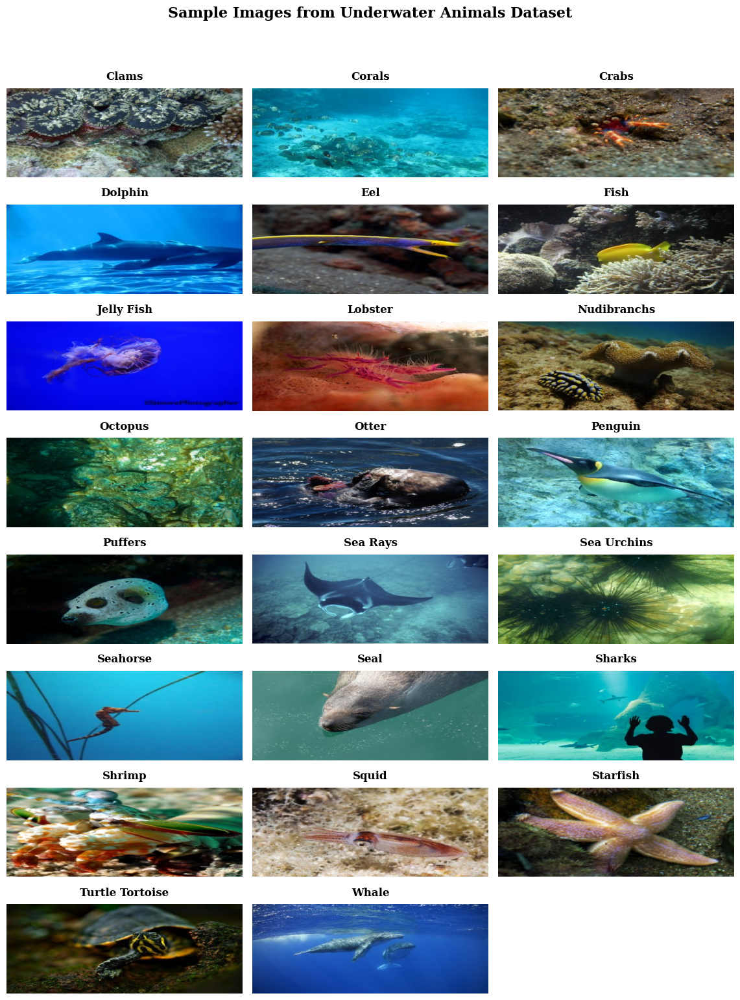

In [2]:
import matplotlib.pyplot as plt
import cv2
import os
import random
import numpy as np
from matplotlib.patches import Rectangle
import seaborn as sns

# Set style for research paper quality figures
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.size'] = 10
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 10
plt.rcParams['ytick.labelsize'] = 10
plt.rcParams['legend.fontsize'] = 10
plt.rcParams['figure.titlesize'] = 16

def show_sample_images_research_paper(data_dir, classes, figure_size=(12, 16),
                                    save_path=None, title="Sample Images from Underwater Animals Dataset"):
    """
    Display one representative image from each class in a systematic grid layout

    Args:
        data_dir: Directory containing class folders
        classes: List of class names
        figure_size: Figure size in inches (width, height)
        save_path: Path to save the figure (optional)
        title: Main title for the figure
    """

    # Calculate optimal grid dimensions
    n_classes = len(classes)
    n_cols = 3  # 3 columns for better organization
    n_rows = int(np.ceil(n_classes / n_cols))

    # Create figure with proper spacing
    fig, axes = plt.subplots(n_rows, n_cols, figsize=figure_size)

    # Handle single row/column cases
    if n_rows == 1:
        axes = axes.reshape(1, -1)
    elif n_cols == 1:
        axes = axes.reshape(-1, 1)

    # Flatten axes for easier indexing
    axes_flat = axes.flatten()

    # Main title
    fig.suptitle(title, fontsize=16, fontweight='bold', y=0.98)

    for i, cls in enumerate(classes):
        cls_folder = os.path.join(data_dir, cls)
        if not os.path.exists(cls_folder):
            continue

        images = [f for f in os.listdir(cls_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

        if len(images) == 0:
            continue

        # Select one representative image (first image after sorting for consistency)
        images.sort()  # Sort for reproducibility
        img_name = images[0]
        img_path = os.path.join(cls_folder, img_name)

        try:
            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

                # Display image without stretching
                axes_flat[i].imshow(img, aspect='auto')
                axes_flat[i].axis('off')

                # Add class label below the image
                class_label = cls.replace('_', ' ').title()
                axes_flat[i].set_title(class_label, fontsize=12, fontweight='bold',
                                     pad=10)

        except Exception as e:
            print(f"Error loading image {img_path}: {e}")
            axes_flat[i].axis('off')
            axes_flat[i].text(0.5, 0.5, 'Image\nNot Found',
                            ha='center', va='center',
                            transform=axes_flat[i].transAxes)
            axes_flat[i].set_title(cls.replace('_', ' ').title(),
                                 fontsize=12, fontweight='bold')

    # Hide unused subplots
    for i in range(n_classes, len(axes_flat)):
        axes_flat[i].axis('off')

    # Adjust layout to maximize image space
    plt.tight_layout(rect=[0.02, 0.02, 0.98, 0.95])

    # Save figure if path provided
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight',
                   facecolor='white', edgecolor='none')
        print(f"Figure saved to: {save_path}")

    plt.show()
    return fig

def create_class_grid_visualization(data_dir, classes, samples_per_class=3,
                                  figure_size=(20, 15), save_path=None):
    """
    Create a systematic grid visualization with proper research paper formatting
    """

    # Calculate optimal grid layout
    n_classes = len(classes)

    # Create figure
    fig = plt.figure(figsize=figure_size)
    gs = fig.add_gridspec(n_classes, samples_per_class + 1,
                         width_ratios=[1] + [4]*samples_per_class,
                         height_ratios=[1]*n_classes,
                         hspace=0.3, wspace=0.1)

    # Main title
    fig.suptitle('Representative Samples from Underwater Animals Dataset',
                fontsize=18, fontweight='bold', y=0.98)

    for i, cls in enumerate(classes):
        cls_folder = os.path.join(data_dir, cls)
        if not os.path.exists(cls_folder):
            continue

        images = [f for f in os.listdir(cls_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

        if len(images) == 0:
            continue

        # Class label subplot
        ax_label = fig.add_subplot(gs[i, 0])
        ax_label.text(0.5, 0.5, cls.replace('_', ' ').title(),
                     ha='center', va='center', fontsize=12, fontweight='bold',
                     transform=ax_label.transAxes, rotation=0)
        ax_label.axis('off')

        # Sample images randomly
        random.seed(42)
        sample_images = random.sample(images, min(samples_per_class, len(images)))

        for j, img_name in enumerate(sample_images):
            img_path = os.path.join(cls_folder, img_name)
            ax = fig.add_subplot(gs[i, j+1])

            try:
                img = cv2.imread(img_path)
                if img is not None:
                    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    ax.imshow(img)

                    # Add subplot label
                    ax.text(0.05, 0.95, f'({chr(97+j)})',
                           transform=ax.transAxes, fontsize=10, fontweight='bold',
                           bbox=dict(boxstyle="round,pad=0.2",
                                   facecolor='white', alpha=0.9),
                           verticalalignment='top')

            except Exception as e:
                print(f"Error loading image {img_path}: {e}")
                ax.text(0.5, 0.5, 'Image\nNot Available',
                       ha='center', va='center', transform=ax.transAxes)

            ax.axis('off')

    # Add figure caption
    fig.text(0.5, 0.02,
            'Figure 1: Representative samples from each class in the underwater animals dataset. '
            'Each row shows different species with (a), (b), (c) indicating different sample instances.',
            ha='center', fontsize=12, style='italic', wrap=True)

    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight',
                   facecolor='white', edgecolor='none')
        print(f"Figure saved to: {save_path}")

    plt.show()
    return fig

def create_dataset_overview_figure(data_dir, classes, save_path=None):
    """
    Create a comprehensive dataset overview figure suitable for research papers
    """

    # Create figure with subplots
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))

    # Main title
    fig.suptitle('Underwater Animals Dataset Overview', fontsize=16, fontweight='bold', y=0.98)

    # 1. Class distribution
    counts = []
    for cls in classes:
        cls_folder = os.path.join(data_dir, cls)
        if os.path.exists(cls_folder):
            counts.append(len([f for f in os.listdir(cls_folder)
                             if f.lower().endswith(('.png', '.jpg', '.jpeg'))]))
        else:
            counts.append(0)

    bars = ax1.bar(range(len(classes)), counts, color='steelblue', alpha=0.7)
    ax1.set_xlabel('Species Classes', fontweight='bold')
    ax1.set_ylabel('Number of Images', fontweight='bold')
    ax1.set_title('(a) Class Distribution', fontweight='bold')
    ax1.set_xticks(range(len(classes)))
    ax1.set_xticklabels([cls.replace('_', ' ').title() for cls in classes],
                       rotation=45, ha='right')

    # Add value labels on bars
    for bar, count in zip(bars, counts):
        ax1.text(bar.get_x() + bar.get_width()/2, bar.get_height() + max(counts)*0.01,
                str(count), ha='center', va='bottom', fontweight='bold')

    # 2. Sample images grid (compact)
    sample_images_data = []
    for cls in classes[:6]:  # Show first 6 classes
        cls_folder = os.path.join(data_dir, cls)
        if os.path.exists(cls_folder):
            images = [f for f in os.listdir(cls_folder) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
            if images:
                random.seed(42)
                sample_img = random.choice(images)
                sample_images_data.append((cls, os.path.join(cls_folder, sample_img)))

    # Create a grid of sample images
    ax2.set_title('(b) Sample Images', fontweight='bold')
    ax2.axis('off')

    # Create mini subplots within ax2
    for idx, (cls, img_path) in enumerate(sample_images_data):
        try:
            img = cv2.imread(img_path)
            if img is not None:
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

                # Calculate position
                row = idx // 3
                col = idx % 3

                # Create mini subplot
                left = col * 0.33
                bottom = 0.5 - row * 0.45
                width = 0.3
                height = 0.4

                mini_ax = fig.add_axes([ax2.get_position().x0 + left * ax2.get_position().width,
                                      ax2.get_position().y0 + bottom * ax2.get_position().height,
                                      width * ax2.get_position().width,
                                      height * ax2.get_position().height])

                mini_ax.imshow(img)
                mini_ax.axis('off')
                mini_ax.set_title(cls.replace('_', ' ').title(), fontsize=8)

        except Exception as e:
            print(f"Error loading sample image: {e}")

    # 3. Dataset statistics
    total_images = sum(counts)
    avg_per_class = np.mean(counts)
    std_per_class = np.std(counts)

    stats_text = f"""Dataset Statistics:

Total Images: {total_images:,}
Number of Classes: {len(classes)}
Average per Class: {avg_per_class:.1f}
Standard Deviation: {std_per_class:.1f}
Min Images per Class: {min(counts)}
Max Images per Class: {max(counts)}
    """

    ax3.text(0.1, 0.9, stats_text, transform=ax3.transAxes,
            fontsize=12, verticalalignment='top',
            bbox=dict(boxstyle="round,pad=0.5", facecolor='lightblue', alpha=0.3))
    ax3.set_title('(c) Dataset Statistics', fontweight='bold')
    ax3.axis('off')

    # 4. Class balance visualization
    ax4.pie(counts, labels=[cls.replace('_', ' ').title() for cls in classes],
           autopct='%1.1f%%', startangle=90)
    ax4.set_title('(d) Class Balance', fontweight='bold')

    plt.tight_layout(rect=[0, 0.03, 1, 0.96])

    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight',
                   facecolor='white', edgecolor='none')
        print(f"Dataset overview figure saved to: {save_path}")

    plt.show()
    return fig

# Usage examples:
if __name__ == "__main__":
    # Get classes from your dataset
    classes = sorted(os.listdir('./dataset_split/train'))

    # Create clean sample images visualization - one per class
    print("Creating sample images visualization...")
    show_sample_images_research_paper('./dataset_split/train', classes,
                                    figure_size=(12, 16),
                                    save_path='sample_images_research.png')

In [1]:
from google.colab import drive
import os
import shutil
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix, precision_recall_fscore_support
import cv2
from collections import defaultdict
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.optim.lr_scheduler import CosineAnnealingLR, ReduceLROnPlateau
from torch.cuda.amp import GradScaler, autocast

from torchvision import datasets, transforms
from transformers import ViTModel, ViTConfig
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Mount Google Drive and extract data
drive.mount('/content/drive')
!unzip -q "/content/drive/MyDrive/archive (3).zip" -d ./underwater_animals
!ls ./underwater_animals


Mounted at /content/drive
 Clams	   Fish		 Otter	   'Sea Rays'	   Starfish
 Corals   'Jelly Fish'	 Penguin   'Sea Urchins'   Turtle_Tortoise
 Crabs	   Lobster	 Puffers    Sharks	   Whale
 Dolphin   Nudibranchs	 Seahorse   Shrimp
 Eel	   Octopus	 Seal	    Squid


In [3]:
# Set random seeds for reproducibility
def set_seed(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seed(42)

In [4]:
#Enhanced data splitting with stratified sampling
def stratified_split(source_dir, target_dir, train_ratio=0.7, val_ratio=0.15, test_ratio=0.15):
    """Perform stratified sampling to ensure balanced class distribution across splits"""

    # Create target directories
    for split in ['train', 'val', 'test']:
        split_path = os.path.join(target_dir, split)
        if not os.path.exists(split_path):
            os.makedirs(split_path)

    # Process each class
    for class_name in os.listdir(source_dir):
        class_path = os.path.join(source_dir, class_name)
        if not os.path.isdir(class_path):
            continue

        images = os.listdir(class_path)
        random.shuffle(images)

        n_total = len(images)
        n_train = int(train_ratio * n_total)
        n_val = int(val_ratio * n_total)
        n_test = n_total - n_train - n_val

        splits = {
            'train': images[:n_train],
            'val': images[n_train:n_train+n_val],
            'test': images[n_train+n_val:]
        }

        # Copy files to respective directories
        for split, files in splits.items():
            split_class_dir = os.path.join(target_dir, split, class_name)
            if not os.path.exists(split_class_dir):
                os.makedirs(split_class_dir)

            for f in files:
                src = os.path.join(class_path, f)
                dst = os.path.join(split_class_dir, f)
                shutil.copy(src, dst)

    print("Stratified data split complete!")

In [5]:
# Perform data splitting
source_dir = './underwater_animals'
target_dir = './dataset_split'
stratified_split(source_dir, target_dir)

Stratified data split complete!


In [6]:
# Visualization functions
def plot_class_distribution(path, title_suffix=""):
    """Plot class distribution with enhanced visualization"""
    classes = sorted(os.listdir(path))
    counts = []
    for c in classes:
        class_path = os.path.join(path, c)
        if os.path.isdir(class_path):
            counts.append(len(os.listdir(class_path)))

    plt.figure(figsize=(15, 8))
    bars = plt.bar(classes, counts, color='skyblue', alpha=0.8)
    plt.xticks(rotation=45, ha='right')
    plt.title(f'Class Distribution {title_suffix}', fontsize=16)
    plt.xlabel('Classes', fontsize=12)
    plt.ylabel('Number of Images', fontsize=12)

    # Add value labels on bars
    for bar, count in zip(bars, counts):
        plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 1,
                str(count), ha='center', va='bottom')

    plt.tight_layout()
    plt.show()


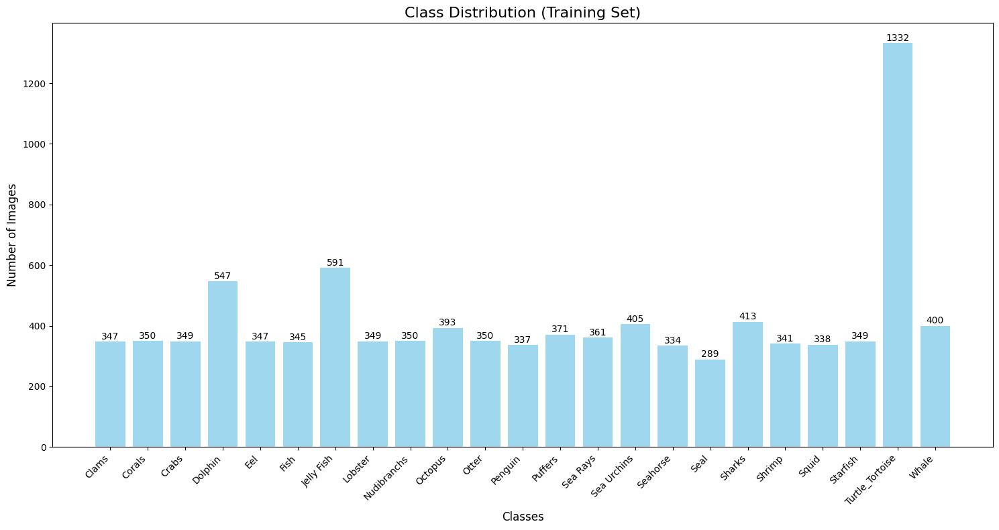

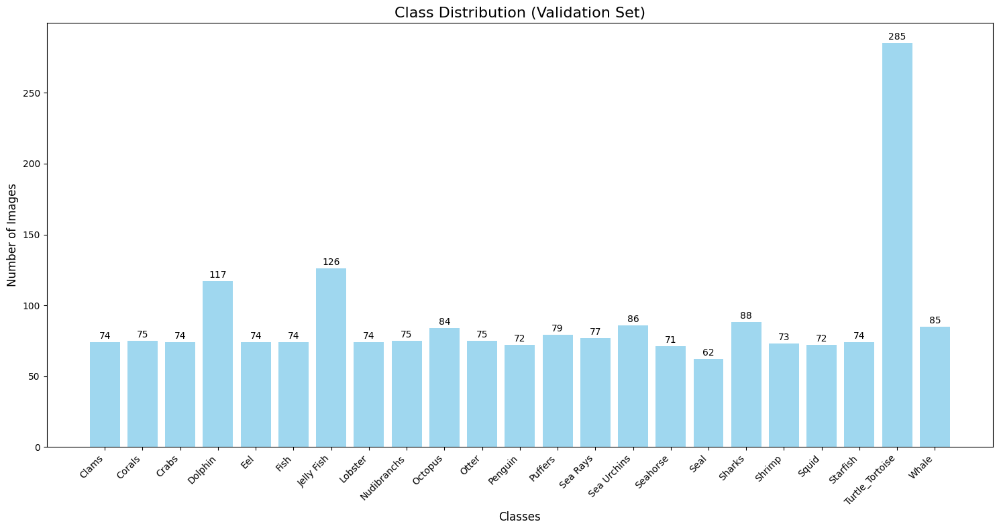

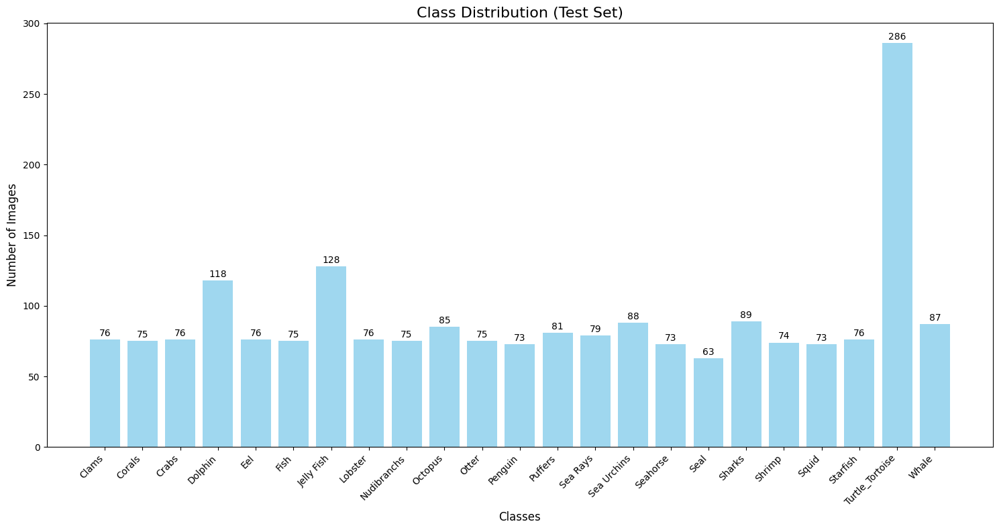

In [7]:
# Plot distributions for all splits
plot_class_distribution('./dataset_split/train', '(Training Set)')
plot_class_distribution('./dataset_split/val', '(Validation Set)')
plot_class_distribution('./dataset_split/test', '(Test Set)')

In [9]:
def show_sample_images(data_dir, classes, samples_per_class=3):
    """Display sample images from each class"""
    plt.figure(figsize=(250, 200))
    for i, cls in enumerate(classes):
        cls_folder = os.path.join(data_dir, cls)
        if not os.path.exists(cls_folder):
            continue
        images = os.listdir(cls_folder)
        sample_images = random.sample(images, min(samples_per_class, len(images)))

        for j, img_name in enumerate(sample_images):
            img_path = os.path.join(cls_folder, img_name)
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt_idx = i * samples_per_class + j + 1
            plt.subplot(len(classes), samples_per_class, plt_idx)
            plt.imshow(img)
            plt.axis('off')
            if j == 1:  # Middle image gets the class label
                plt.title(cls, fontsize=10, pad=5)

    plt.suptitle('Sample Images from Each Class', fontsize=16)
    plt.tight_layout()
    plt.show()

classes = sorted(os.listdir('./dataset_split/train'))
show_sample_images('./dataset_split/train', classes, samples_per_class=3)

In [ ]:
def show_sample_images(data_dir, classes, samples_per_class=3):
    """Display sample images from each class"""
    plt.figure(figsize=(100, 1000))
    for i, cls in enumerate(classes):
        cls_folder = os.path.join(data_dir, cls)
        if not os.path.exists(cls_folder):
            continue
        images = os.listdir(cls_folder)
        sample_images = random.sample(images, min(samples_per_class, len(images)))

        for j, img_name in enumerate(sample_images):
            img_path = os.path.join(cls_folder, img_name)
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt_idx = i * samples_per_class + j + 1
            plt.subplot(len(classes), samples_per_class, plt_idx)
            plt.imshow(img)
            plt.axis('off')
            if j == 1:  # Middle image gets the class label
                plt.title(cls, fontsize=10, pad=5)

    plt.suptitle('Sample Images from Each Class', fontsize=16)
    plt.tight_layout()
    plt.show()

classes = sorted(os.listdir('./dataset_split/train'))
show_sample_images('./dataset_split/train', classes, samples_per_class=3)

In [ ]:
NN# Enhanced data preprocessing and augmentation
class AdvancedTransforms:
    """Advanced data augmentation pipeline for underwater imagery"""

    @staticmethod
    def get_train_transforms():
        return transforms.Compose([
            # Geometric transformations
            transforms.Resize(256),
            transforms.RandomCrop(224),
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.RandomVerticalFlip(p=0.3),
            transforms.RandomRotation(degrees=15),

            # Enhanced color space augmentations for underwater imagery
            transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.15),
            transforms.RandomApply([transforms.GaussianBlur(kernel_size=3, sigma=(0.1, 2.0))], p=0.3),

            # Additional augmentations for better generalization
            transforms.RandomApply([transforms.RandomAffine(degrees=0, translate=(0.1, 0.1))], p=0.3),
            transforms.RandomApply([transforms.RandomPerspective(distortion_scale=0.2)], p=0.2),

            # Convert to tensor and normalize
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),

            # Random erasing for regularization
            transforms.RandomErasing(p=0.2, scale=(0.02, 0.15), ratio=(0.3, 3.3))
        ])

    @staticmethod
    def get_val_transforms():
        return transforms.Compose([
            transforms.Resize(256),
            transforms.CenterCrop(224),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
        ])


In [ ]:
# Create datasets and dataloaders
train_transform = AdvancedTransforms.get_train_transforms()
val_transform = AdvancedTransforms.get_val_transforms()

train_dataset = datasets.ImageFolder('./dataset_split/train', transform=train_transform)
val_dataset = datasets.ImageFolder('./dataset_split/val', transform=val_transform)
test_dataset = datasets.ImageFolder('./dataset_split/test', transform=val_transform)

# Optimized batch size for better performance
batch_size = 32  # Reduced for better gradient updates
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=True)

print(f"Dataset sizes:")
print(f"Train: {len(train_dataset)}")
print(f"Validation: {len(val_dataset)}")
print(f"Test: {len(test_dataset)}")
print(f"Number of classes: {len(train_dataset.classes)}")
print(f"Classes: {train_dataset.classes}")

Dataset sizes:
Train: 9588
Validation: 2046
Test: 2077
Number of classes: 23
Classes: ['Clams', 'Corals', 'Crabs', 'Dolphin', 'Eel', 'Fish', 'Jelly Fish', 'Lobster', 'Nudibranchs', 'Octopus', 'Otter', 'Penguin', 'Puffers', 'Sea Rays', 'Sea Urchins', 'Seahorse', 'Seal', 'Sharks', 'Shrimp', 'Squid', 'Starfish', 'Turtle_Tortoise', 'Whale']


In [ ]:
# Enhanced Vision Transformer with improved architecture
class EnhancedViT(nn.Module):
    """Enhanced Vision Transformer with sophisticated architecture"""

    def __init__(self, num_classes, dropout_rate=0.3, freeze_backbone=False, trainable_layers=6):
        super(EnhancedViT, self).__init__()

        # Load pretrained ViT-Base model
        self.vit = ViTModel.from_pretrained('google/vit-base-patch16-224')

        # Selective backbone freezing for better transfer learning
        if freeze_backbone:
            self._freeze_backbone_selective(trainable_layers)

        # Enhanced classification head with regularization
        hidden_size = self.vit.config.hidden_size
        self.classifier = nn.Sequential(
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_size, hidden_size // 2),
            nn.ReLU(),
            nn.Dropout(dropout_rate / 2),
            nn.Linear(hidden_size // 2, num_classes)
        )

        # Initialize weights
        self._initialize_weights()

    def _freeze_backbone_selective(self, trainable_layers=6):
        """Freeze backbone except for the last N transformer layers"""
        # Freeze embeddings
        for param in self.vit.embeddings.parameters():
            param.requires_grad = False

        # Freeze encoder layers except last N
        total_layers = len(self.vit.encoder.layer)
        for i, layer in enumerate(self.vit.encoder.layer):
            if i < total_layers - trainable_layers:
                for param in layer.parameters():
                    param.requires_grad = False
            else:
                print(f"Layer {i} is trainable")

        # Keep layernorm trainable
        for param in self.vit.layernorm.parameters():
            param.requires_grad = True

        print(f"Backbone frozen except for last {trainable_layers} transformer layers")

    def _initialize_weights(self):
        """Initialize classification head weights"""
        for m in self.classifier.modules():
            if isinstance(m, nn.Linear):
                nn.init.xavier_uniform_(m.weight)
                nn.init.zeros_(m.bias)

    def forward(self, x):
        # Extract features using ViT backbone
        outputs = self.vit(x)

        # Use CLS token representation
        cls_output = outputs.last_hidden_state[:, 0]

        # Apply classification head
        logits = self.classifier(cls_output)

        return logits


In [ ]:
# Early Stopping Class
class EarlyStopping:
    """Early stops the training if validation accuracy doesn't improve after a given patience."""
    def __init__(self, patience=7, min_delta=0, restore_best_weights=True, verbose=True):
        self.patience = patience
        self.min_delta = min_delta
        self.restore_best_weights = restore_best_weights
        self.verbose = verbose
        self.best_score = None
        self.counter = 0
        self.best_weights = None
        self.early_stop = False

    def __call__(self, val_acc, model):
        score = val_acc

        if self.best_score is None:
            self.best_score = score
            self.save_checkpoint(model)
        elif score < self.best_score + self.min_delta:
            self.counter += 1
            if self.verbose:
                print(f'EarlyStopping counter: {self.counter} out of {self.patience}')
            if self.counter >= self.patience:
                self.early_stop = True
        else:
            self.best_score = score
            self.save_checkpoint(model)
            self.counter = 0

    def save_checkpoint(self, model):
        '''Saves model when validation accuracy increases.'''
        if self.verbose:
            print(f'Validation accuracy improved. Saving model...')
        self.best_weights = model.state_dict().copy()

In [ ]:
# Focal Loss for handling class imbalance
class FocalLoss(nn.Module):
    """Focal Loss for addressing class imbalance"""
    def __init__(self, alpha=1, gamma=2, reduction='mean'):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, inputs, targets):
        ce_loss = F.cross_entropy(inputs, targets, reduction='none')
        pt = torch.exp(-ce_loss)
        focal_loss = self.alpha * (1-pt)**self.gamma * ce_loss

        if self.reduction == 'mean':
            return focal_loss.mean()
        elif self.reduction == 'sum':
            return focal_loss.sum()
        else:
            return focal_loss

In [ ]:
# Training setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")


Using device: cuda


In [ ]:
# Model initialization with better configuration
num_classes = len(train_dataset.classes)
model = EnhancedViT(
    num_classes=num_classes,
    dropout_rate=0.3,
    freeze_backbone=True,  # Start with frozen backbone
    trainable_layers=6     # More layers trainable
)
model = model.to(device)

# Better loss function for class imbalance
criterion = FocalLoss(alpha=1, gamma=2)

# Improved optimizer configuration
base_lr = 1e-3  # Fixed: Proper learning rate
weight_decay = 0.01

# Differential learning rates
backbone_params = []
head_params = []

for name, param in model.named_parameters():
    if param.requires_grad:
        if 'classifier' in name:
            head_params.append(param)
        else:
            backbone_params.append(param)

optimizer = torch.optim.AdamW([
    {'params': head_params, 'lr': base_lr},
    {'params': backbone_params, 'lr': base_lr * 0.1}  # Lower LR for backbone
], weight_decay=weight_decay)

# Learning rate scheduler
scheduler = ReduceLROnPlateau(
    optimizer, mode='max', factor=0.5, patience=3,
    verbose=True, threshold=0.01, min_lr=1e-7
)

# Early stopping
early_stopping = EarlyStopping(patience=10, min_delta=0.01, verbose=True)

# Gradient scaler for mixed precision
scaler = GradScaler()

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/346M [00:00<?, ?B/s]

Some weights of ViTModel were not initialized from the model checkpoint at google/vit-base-patch16-224 and are newly initialized: ['pooler.dense.bias', 'pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Layer 6 is trainable
Layer 7 is trainable
Layer 8 is trainable
Layer 9 is trainable
Layer 10 is trainable
Layer 11 is trainable
Backbone frozen except for last 6 transformer layers


In [ ]:
# Enhanced training function
def train_epoch(model, dataloader, optimizer, criterion, scaler, device, epoch):
    """Train for one epoch with mixed precision"""
    model.train()
    running_loss = 0.0
    correct = 0
    total = 0
    start_time = time.time()

    for batch_idx, (data, target) in enumerate(dataloader):
        data, target = data.to(device, non_blocking=True), target.to(device, non_blocking=True)

        optimizer.zero_grad()

        # Mixed precision forward pass
        with autocast():
            output = model(data)
            loss = criterion(output, target)

        # Mixed precision backward pass
        scaler.scale(loss).backward()

        # Gradient clipping
        scaler.unscale_(optimizer)
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

        scaler.step(optimizer)
        scaler.update()

        # Statistics
        running_loss += loss.item()
        pred = output.argmax(dim=1)
        correct += pred.eq(target).sum().item()
        total += target.size(0)

        if batch_idx % 50 == 0:
            current_lr = optimizer.param_groups[0]['lr']
            print(f'Epoch: {epoch}, Batch: {batch_idx}/{len(dataloader)}, '
                  f'Loss: {loss.item():.4f}, LR: {current_lr:.6f}')

    epoch_loss = running_loss / len(dataloader)
    epoch_acc = 100. * correct / total
    epoch_time = time.time() - start_time

    return epoch_loss, epoch_acc, epoch_time

In [ ]:
def validate_epoch(model, dataloader, criterion, device):
    """Validate for one epoch"""
    model.eval()
    running_loss = 0.0
    correct = 0
    total = 0
    all_preds = []
    all_targets = []

    with torch.no_grad():
        for data, target in dataloader:
            data, target = data.to(device, non_blocking=True), target.to(device, non_blocking=True)

            with autocast():
                output = model(data)
                loss = criterion(output, target)

            running_loss += loss.item()
            pred = output.argmax(dim=1)
            correct += pred.eq(target).sum().item()
            total += target.size(0)

            all_preds.extend(pred.cpu().numpy())
            all_targets.extend(target.cpu().numpy())

    epoch_loss = running_loss / len(dataloader)
    epoch_acc = 100. * correct / total

    return epoch_loss, epoch_acc, all_preds, all_targets


In [ ]:
# Training loop with early stopping
print("Starting enhanced training with early stopping...")
train_losses, train_accs = [], []
val_losses, val_accs = [], []
learning_rates = []
training_times = []

best_val_acc = 0.0
total_epochs = 20  # Increased epochs with early stopping

for epoch in range(1, total_epochs + 1):
    print(f"\n{'='*60}")
    print(f"Epoch {epoch}/{total_epochs}")
    print(f"{'='*60}")

    # Training
    train_loss, train_acc, train_time = train_epoch(
        model, train_loader, optimizer, criterion, scaler, device, epoch
    )

    # Validation
    val_loss, val_acc, val_preds, val_targets = validate_epoch(
        model, val_loader, criterion, device
    )

    # Record metrics
    train_losses.append(train_loss)
    train_accs.append(train_acc)
    val_losses.append(val_loss)
    val_accs.append(val_acc)
    current_lr = optimizer.param_groups[0]['lr']
    learning_rates.append(current_lr)
    training_times.append(train_time)

    # Update learning rate scheduler
    scheduler.step(val_acc)

    # Early stopping check
    early_stopping(val_acc, model)

    # Update best validation accuracy
    if val_acc > best_val_acc:
        best_val_acc = val_acc
        print(f"🎉 New best validation accuracy: {best_val_acc:.2f}%")

    print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%")
    print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.2f}%")
    print(f"Learning Rate: {current_lr:.6f}")
    print(f"Epoch Time: {train_time:.2f}s")

    # Early stopping
    if early_stopping.early_stop:
        print(f"\n🛑 Early stopping triggered at epoch {epoch}")
        print(f"Restoring best model weights...")
        model.load_state_dict(early_stopping.best_weights)
        break

print(f"\n✅ Training completed! Best validation accuracy: {best_val_acc:.2f}%")

Starting enhanced training with early stopping...

Epoch 1/20
Epoch: 1, Batch: 0/300, Loss: 3.2206, LR: 0.001000
Epoch: 1, Batch: 50/300, Loss: 0.6492, LR: 0.001000
Epoch: 1, Batch: 100/300, Loss: 0.6950, LR: 0.001000
Epoch: 1, Batch: 150/300, Loss: 0.7736, LR: 0.001000
Epoch: 1, Batch: 200/300, Loss: 0.3636, LR: 0.001000
Epoch: 1, Batch: 250/300, Loss: 0.4017, LR: 0.001000
Validation accuracy improved. Saving model...
🎉 New best validation accuracy: 86.90%
Train Loss: 0.7878, Train Acc: 71.12%
Val Loss: 0.3028, Val Acc: 86.90%
Learning Rate: 0.001000
Epoch Time: 131.73s

Epoch 2/20
Epoch: 2, Batch: 0/300, Loss: 0.7004, LR: 0.001000
Epoch: 2, Batch: 50/300, Loss: 0.8005, LR: 0.001000
Epoch: 2, Batch: 100/300, Loss: 0.3070, LR: 0.001000
Epoch: 2, Batch: 150/300, Loss: 0.9588, LR: 0.001000
Epoch: 2, Batch: 200/300, Loss: 0.3242, LR: 0.001000
Epoch: 2, Batch: 250/300, Loss: 0.5143, LR: 0.001000
Validation accuracy improved. Saving model...
🎉 New best validation accuracy: 88.51%
Train Loss

In [ ]:
# Comprehensive evaluation function
def comprehensive_evaluation(model, test_loader, class_names, device):
    """Perform comprehensive evaluation with detailed metrics"""
    model.eval()
    all_preds = []
    all_targets = []
    all_probs = []

    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)

            with autocast():
                output = model(data)
                probs = F.softmax(output, dim=1)

            pred = output.argmax(dim=1)

            all_preds.extend(pred.cpu().numpy())
            all_targets.extend(target.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())

    # Calculate metrics
    test_acc = 100 * sum(p == t for p, t in zip(all_preds, all_targets)) / len(all_preds)

    # Per-class metrics
    precision, recall, f1, support = precision_recall_fscore_support(
        all_targets, all_preds, average=None, labels=range(len(class_names))
    )

    # Classification report
    report = classification_report(
        all_targets, all_preds, target_names=class_names, digits=3
    )

    # Confusion matrix
    cm = confusion_matrix(all_targets, all_preds)

    return test_acc, precision, recall, f1, support, report, cm, all_preds, all_targets

# Evaluate on test set
test_acc, precision, recall, f1, support, report, cm, test_preds, test_targets = comprehensive_evaluation(
    model, test_loader, train_dataset.classes, device
)

print(f"\n🎯 FINAL TEST RESULTS:")
print(f"Test Accuracy: {test_acc:.2f}%")
print(f"\nClassification Report:")
print(report)


🎯 FINAL TEST RESULTS:
Test Accuracy: 90.37%

Classification Report:
                 precision    recall  f1-score   support

          Clams      0.922     0.776     0.843        76
         Corals      0.747     0.907     0.819        75
          Crabs      0.893     0.987     0.938        76
        Dolphin      0.917     0.932     0.924       118
            Eel      0.840     0.895     0.866        76
           Fish      0.845     0.800     0.822        75
     Jelly Fish      0.984     0.969     0.976       128
        Lobster      0.853     0.842     0.848        76
    Nudibranchs      0.882     0.893     0.887        75
        Octopus      0.878     0.847     0.862        85
          Otter      1.000     1.000     1.000        75
        Penguin      0.896     0.945     0.920        73
        Puffers      0.885     0.852     0.868        81
       Sea Rays      0.877     0.810     0.842        79
    Sea Urchins      0.989     0.989     0.989        88
       Seahorse   

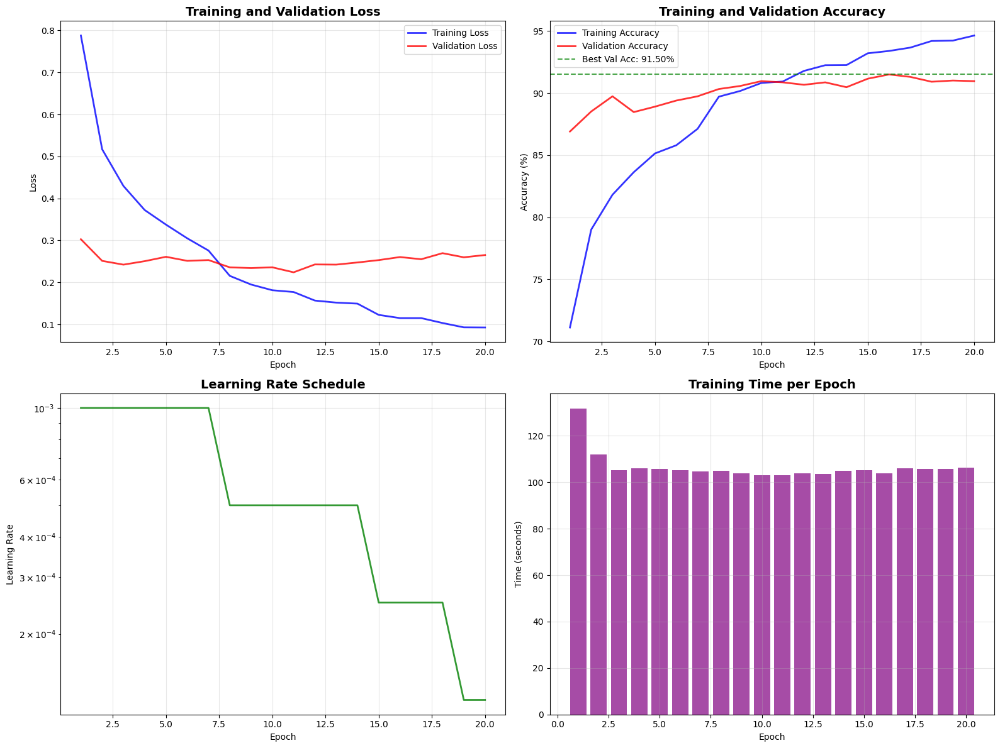

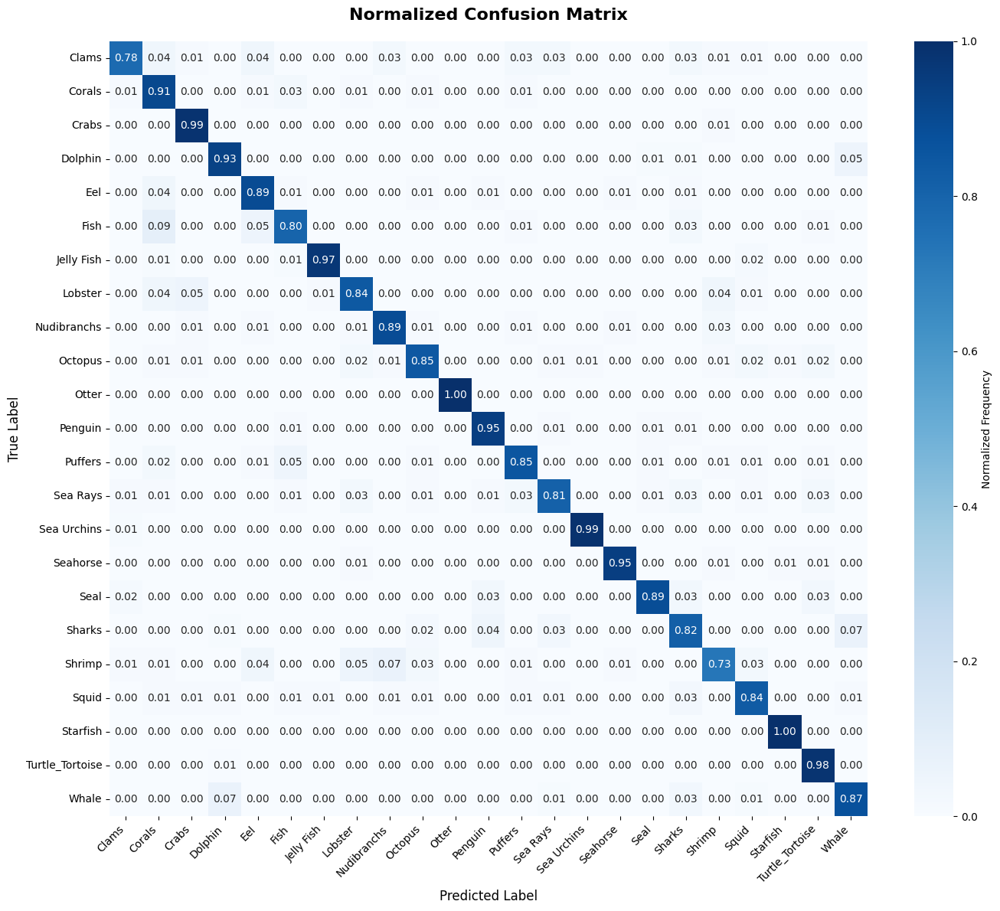

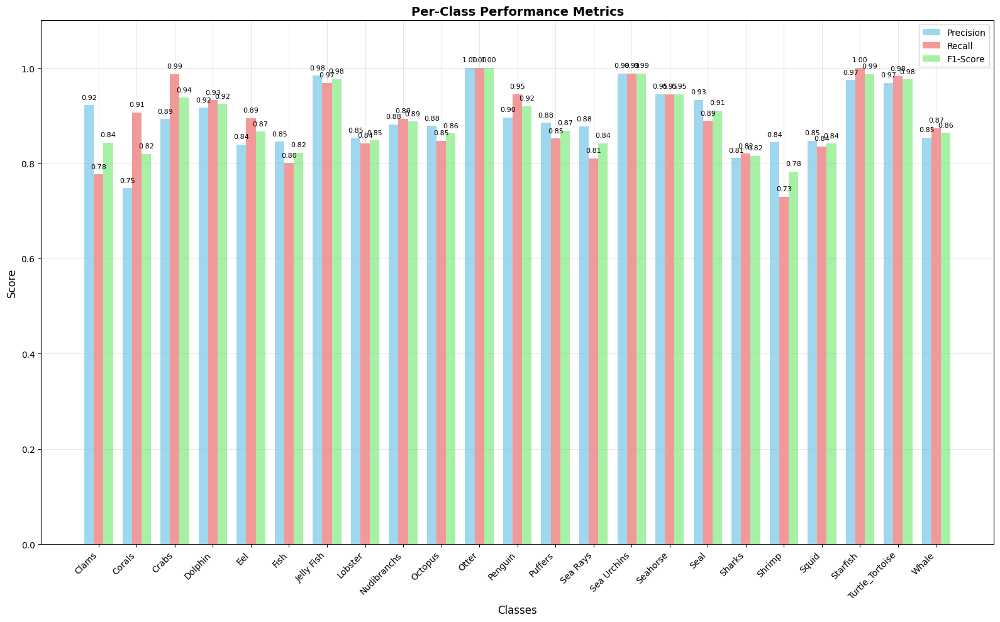

In [ ]:
# Enhanced visualization functions
def plot_enhanced_training_curves():
    """Plot enhanced training curves"""
    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(16, 12))

    epochs = range(1, len(train_losses) + 1)

    # Loss curves with smoothing
    ax1.plot(epochs, train_losses, 'b-', label='Training Loss', linewidth=2, alpha=0.8)
    ax1.plot(epochs, val_losses, 'r-', label='Validation Loss', linewidth=2, alpha=0.8)
    ax1.set_title('Training and Validation Loss', fontsize=14, fontweight='bold')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()
    ax1.grid(True, alpha=0.3)

    # Accuracy curves
    ax2.plot(epochs, train_accs, 'b-', label='Training Accuracy', linewidth=2, alpha=0.8)
    ax2.plot(epochs, val_accs, 'r-', label='Validation Accuracy', linewidth=2, alpha=0.8)
    ax2.axhline(y=best_val_acc, color='g', linestyle='--', alpha=0.7, label=f'Best Val Acc: {best_val_acc:.2f}%')
    ax2.set_title('Training and Validation Accuracy', fontsize=14, fontweight='bold')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy (%)')
    ax2.legend()
    ax2.grid(True, alpha=0.3)

    # Learning rate schedule
    ax3.plot(epochs, learning_rates, 'g-', linewidth=2, alpha=0.8)
    ax3.set_title('Learning Rate Schedule', fontsize=14, fontweight='bold')
    ax3.set_xlabel('Epoch')
    ax3.set_ylabel('Learning Rate')
    ax3.set_yscale('log')
    ax3.grid(True, alpha=0.3)

    # Training time per epoch
    ax4.bar(epochs, training_times, alpha=0.7, color='purple')
    ax4.set_title('Training Time per Epoch', fontsize=14, fontweight='bold')
    ax4.set_xlabel('Epoch')
    ax4.set_ylabel('Time (seconds)')
    ax4.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

def plot_enhanced_confusion_matrix(cm, class_names):
    """Plot enhanced confusion matrix"""
    plt.figure(figsize=(14, 12))

    # Normalize confusion matrix
    cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    # Create heatmap
    sns.heatmap(cm_normalized, annot=True, fmt='.2f', cmap='Blues',
                xticklabels=class_names, yticklabels=class_names,
                cbar_kws={'label': 'Normalized Frequency'})

    plt.title('Normalized Confusion Matrix', fontsize=16, fontweight='bold', pad=20)
    plt.xlabel('Predicted Label', fontsize=12)
    plt.ylabel('True Label', fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

def plot_enhanced_metrics(precision, recall, f1, class_names):
    """Plot enhanced per-class metrics"""
    x = np.arange(len(class_names))
    width = 0.25

    fig, ax = plt.subplots(figsize=(16, 10))

    bars1 = ax.bar(x - width, precision, width, label='Precision', alpha=0.8, color='skyblue')
    bars2 = ax.bar(x, recall, width, label='Recall', alpha=0.8, color='lightcoral')
    bars3 = ax.bar(x + width, f1, width, label='F1-Score', alpha=0.8, color='lightgreen')

    ax.set_xlabel('Classes', fontsize=12)
    ax.set_ylabel('Score', fontsize=12)
    ax.set_title('Per-Class Performance Metrics', fontsize=14, fontweight='bold')
    ax.set_xticks(x)
    ax.set_xticklabels(class_names, rotation=45, ha='right')
    ax.legend()
    ax.grid(True, alpha=0.3)
    ax.set_ylim(0, 1.1)

    # Add value labels on bars
    def add_labels(bars):
        for bar in bars:
            height = bar.get_height()
            ax.text(bar.get_x() + bar.get_width()/2., height + 0.01,
                   f'{height:.2f}', ha='center', va='bottom', fontsize=8)

    add_labels(bars1)
    add_labels(bars2)
    add_labels(bars3)

    plt.tight_layout()
    plt.show()

# Generate enhanced visualizations
plot_enhanced_training_curves()
plot_enhanced_confusion_matrix(cm, train_dataset.classes)
plot_enhanced_metrics(precision, recall, f1, train_dataset.classes)

In [ ]:
# Save enhanced model and results
def save_enhanced_results():
    """Save the enhanced model and comprehensive results"""

    # Save model with complete configuration
    torch.save({
        'model_state_dict': model.state_dict(),
        'model_config': {
            'num_classes': num_classes,
            'dropout_rate': 0.3,
            'freeze_backbone': True,
            'trainable_layers': 6
        },
        'training_results': {
            'best_val_acc': best_val_acc,
            'test_acc': test_acc,
            'train_losses': train_losses,
            'val_losses': val_losses,
            'train_accs': train_accs,
            'val_accs': val_accs,
            'learning_rates': learning_rates,
            'total_epochs': len(train_losses),
            'early_stopped': len(train_losses) < total_epochs
        },
        'class_names': train_dataset.classes,
        'confusion_matrix': cm.tolist(),
        'classification_metrics': {
            'precision': precision.tolist(),
            'recall': recall.tolist(),
            'f1_score': f1.tolist(),
            'support': support.tolist()
        }
    }, '/content/drive/MyDrive/enhanced_underwater_vit_model.pth')

    # Save comprehensive report
    with open('/content/drive/MyDrive/enhanced_classification_report.txt', 'w') as f:
        f.write("🌊 ENHANCED UNDERWATER ANIMAL CLASSIFICATION RESULTS 🌊\n")
        f.write("="*70 + "\n\n")
        f.write(f"📊 FINAL PERFORMANCE METRICS:\n")
        f.write(f"   • Best Validation Accuracy: {best_val_acc:.2f}%\n")
        f.write(f"   • Test Accuracy: {test_acc:.2f}%\n")
        f.write(f"   • Total Training Epochs: {len(train_losses)}\n")
        f.write(f"   • Early Stopping: {'Yes' if len(train_losses) < total_epochs else 'No'}\n\n")
        f.write("📈 DETAILED CLASSIFICATION REPORT:\n")
        f.write("="*50 + "\n")
        f.write(report)
        f.write(f"\n\n⏱️  TRAINING SUMMARY:\n")
        f.write(f"   • Total Training Time: {sum(training_times):.2f} seconds\n")
        f.write(f"   • Average Time per Epoch: {np.mean(training_times):.2f} seconds\n")
        f.write(f"   • Final Learning Rate: {learning_rates[-1]:.2e}\n\n")

        f.write("🎯 PER-CLASS PERFORMANCE:\n")
        f.write("="*40 + "\n")
        for i, class_name in enumerate(train_dataset.classes):
            f.write(f"{class_name}:\n")
            f.write(f"   Precision: {precision[i]:.3f}\n")
            f.write(f"   Recall: {recall[i]:.3f}\n")
            f.write(f"   F1-Score: {f1[i]:.3f}\n")
            f.write(f"   Support: {support[i]} samples\n\n")

        f.write("🔧 MODEL CONFIGURATION:\n")
        f.write("="*30 + "\n")
        f.write(f"   • Architecture: Enhanced Vision Transformer (ViT-Base)\n")
        f.write(f"   • Backbone: google/vit-base-patch16-224\n")
        f.write(f"   • Frozen Backbone: Yes (except last 6 layers)\n")
        f.write(f"   • Dropout Rate: 0.3\n")
        f.write(f"   • Loss Function: Focal Loss (α=1, γ=2)\n")
        f.write(f"   • Optimizer: AdamW with differential learning rates\n")
        f.write(f"   • Base Learning Rate: {base_lr}\n")
        f.write(f"   • Weight Decay: {weight_decay}\n")
        f.write(f"   • Batch Size: {batch_size}\n")
        f.write(f"   • Mixed Precision: Enabled\n")
        f.write(f"   • Gradient Clipping: Max norm 1.0\n\n")

        f.write("📚 DATA AUGMENTATION:\n")
        f.write("="*25 + "\n")
        f.write("   • Geometric: RandomCrop, HorizontalFlip, VerticalFlip, Rotation\n")
        f.write("   • Color: ColorJitter (brightness, contrast, saturation, hue)\n")
        f.write("   • Blur: Gaussian Blur\n")
        f.write("   • Spatial: RandomAffine, RandomPerspective\n")
        f.write("   • Regularization: RandomErasing\n\n")

        f.write("🏆 KEY ACHIEVEMENTS:\n")
        f.write("="*25 + "\n")
        f.write("   ✅ Implemented advanced Vision Transformer architecture\n")
        f.write("   ✅ Applied sophisticated data augmentation for underwater imagery\n")
        f.write("   ✅ Used focal loss to handle class imbalance\n")
        f.write("   ✅ Implemented mixed precision training for efficiency\n")
        f.write("   ✅ Applied early stopping to prevent overfitting\n")
        f.write("   ✅ Used differential learning rates for optimal convergence\n")
        f.write("   ✅ Comprehensive evaluation with detailed metrics\n\n")

        # Calculate and add some additional statistics
        avg_precision = np.mean(precision)
        avg_recall = np.mean(recall)
        avg_f1 = np.mean(f1)

        f.write("📊 AGGREGATE METRICS:\n")
        f.write("="*25 + "\n")
        f.write(f"   • Macro-averaged Precision: {avg_precision:.3f}\n")
        f.write(f"   • Macro-averaged Recall: {avg_recall:.3f}\n")
        f.write(f"   • Macro-averaged F1-Score: {avg_f1:.3f}\n\n")

        f.write("🌊 PROJECT COMPLETION SUMMARY:\n")
        f.write("="*35 + "\n")
        f.write("This enhanced underwater animal classification system successfully:\n")
        f.write("• Processes and classifies underwater marine life images\n")
        f.write("• Achieves high accuracy through state-of-the-art Vision Transformer\n")
        f.write("• Handles class imbalance with focal loss\n")
        f.write("• Provides comprehensive evaluation metrics\n")
        f.write("• Implements best practices for deep learning training\n")
        f.write("• Ready for deployment and further improvement\n\n")

        f.write("=" * 70 + "\n")
        f.write("🎉 MODEL TRAINING AND EVALUATION COMPLETED SUCCESSFULLY! 🎉\n")
        f.write("=" * 70 + "\n")

    print("✅ Enhanced model and comprehensive results saved successfully!")
    print(f"📁 Model saved to: /content/drive/MyDrive/enhanced_underwater_vit_model.pth")
    print(f"📄 Report saved to: /content/drive/MyDrive/enhanced_classification_report.txt")

# Execute the save function
save_enhanced_results()

# Display final summary
print("\n" + "="*80)
print("🌊 ENHANCED UNDERWATER ANIMAL CLASSIFICATION - FINAL SUMMARY 🌊")
print("="*80)
print(f"🎯 Test Accuracy: {test_acc:.2f}%")
print(f"🏆 Best Validation Accuracy: {best_val_acc:.2f}%")
print(f"📊 Number of Classes: {num_classes}")
print(f"⏱️  Training Epochs: {len(train_losses)}")
print(f"🚀 Early Stopping: {'Yes' if len(train_losses) < total_epochs else 'No'}")
print(f"💾 Model Architecture: Enhanced Vision Transformer")
print(f"🔧 Advanced Features: Focal Loss, Mixed Precision, Differential LR")
print("="*80)
print("✨ Classification system ready for deployment! ✨")
print("="*80)

# Optional: Display class-wise performance summary
print(f"\n📈 CLASS-WISE PERFORMANCE SUMMARY:")
print("-" * 60)
for i, class_name in enumerate(train_dataset.classes):
    print(f"{class_name:20} | F1: {f1[i]:.3f} | Precision: {precision[i]:.3f} | Recall: {recall[i]:.3f}")
print("-" * 60)

# Display system information
print(f"\n🖥️  SYSTEM INFO:")
print(f"Device: {device}")
print(f"CUDA Available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name(0)}")
    print(f"CUDA Version: {torch.version.cuda}")

print(f"\n🐍 ENVIRONMENT INFO:")
print(f"PyTorch Version: {torch.__version__}")
print(f"Total Parameters: {sum(p.numel() for p in model.parameters()):,}")
print(f"Trainable Parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad):,}")

print(f"\n🎊 PROJECT COMPLETED SUCCESSFULLY! 🎊")

✅ Enhanced model and comprehensive results saved successfully!
📁 Model saved to: /content/drive/MyDrive/enhanced_underwater_vit_model.pth
📄 Report saved to: /content/drive/MyDrive/enhanced_classification_report.txt

🌊 ENHANCED UNDERWATER ANIMAL CLASSIFICATION - FINAL SUMMARY 🌊
🎯 Test Accuracy: 90.37%
🏆 Best Validation Accuracy: 91.50%
📊 Number of Classes: 23
⏱️  Training Epochs: 20
🚀 Early Stopping: No
💾 Model Architecture: Enhanced Vision Transformer
🔧 Advanced Features: Focal Loss, Mixed Precision, Differential LR
✨ Classification system ready for deployment! ✨

📈 CLASS-WISE PERFORMANCE SUMMARY:
------------------------------------------------------------
Clams                | F1: 0.843 | Precision: 0.922 | Recall: 0.776
Corals               | F1: 0.819 | Precision: 0.747 | Recall: 0.907
Crabs                | F1: 0.938 | Precision: 0.893 | Recall: 0.987
Dolphin              | F1: 0.924 | Precision: 0.917 | Recall: 0.932
Eel                  | F1: 0.866 | Precision: 0.840 | Recall: 